In [2]:
import numpy as np
import math
import gmpy2
import matplotlib as mpl
from gmpy2 import powmod,mpz,isqrt,invert
from qiskit.aqua.algorithms import Shor
from qiskit.aqua import QuantumInstance
from qiskit import Aer,execute,QuantumCircuit, QuantumRegister, ClassicalRegister
from qiskit.tools.visualization import plot_histogram,circuit_drawer
from qiskit.providers.ibmq import least_busy
from qiskit import IBMQ, execute

In [3]:
from qiskit.aqua.algorithms import Shor
a, N = 2, 51
shor = Shor(N, a)
circuit = shor.construct_circuit()

In [4]:
circuit.measure_all()

backend = Aer.get_backend('qasm_simulator')
quantum_instance = QuantumInstance(backend)
job = execute(circuit, backend, shots=1024)

# Grab results from the job
result = job.result()

In [5]:
# Returns counts
counts = result.get_counts(circuit)

In [6]:
print(circuit.draw()) 

           ┌──────────┐                                                      »
   up_0: ──┤ U2(0,pi) ├──────────────────────────────────────────────────────»
           ├──────────┤                                                      »
   up_1: ──┤ U2(0,pi) ├──────────────────────────────────────────────────────»
           ├──────────┤                                                      »
   up_2: ──┤ U2(0,pi) ├──────────────────────────────────────────────────────»
           ├──────────┤                                                      »
   up_3: ──┤ U2(0,pi) ├──────────────────────────────────────────────────────»
           ├──────────┤                                                      »
   up_4: ──┤ U2(0,pi) ├──────────────────────────────────────────────────────»
           ├──────────┤                                                      »
   up_5: ──┤ U2(0,pi) ├──────────────────────────────────────────────────────»
           ├──────────┤                             

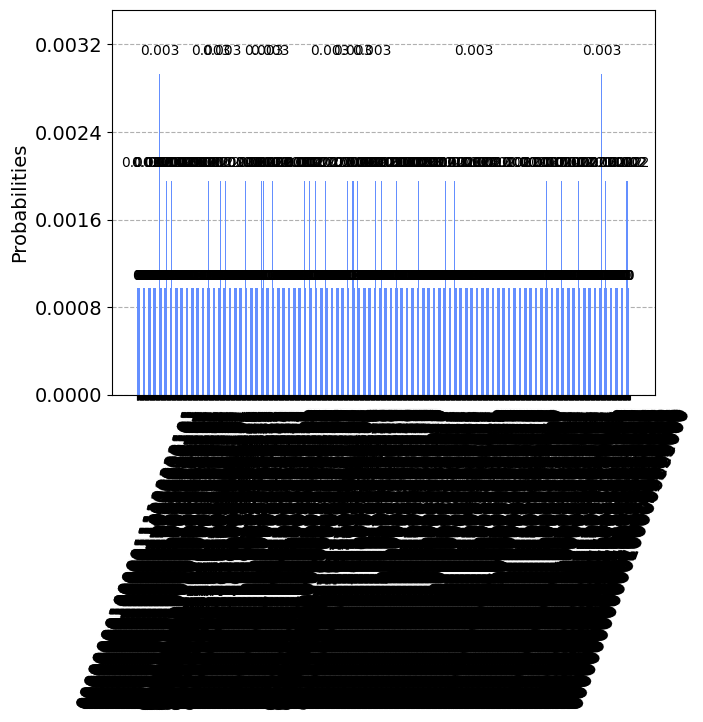

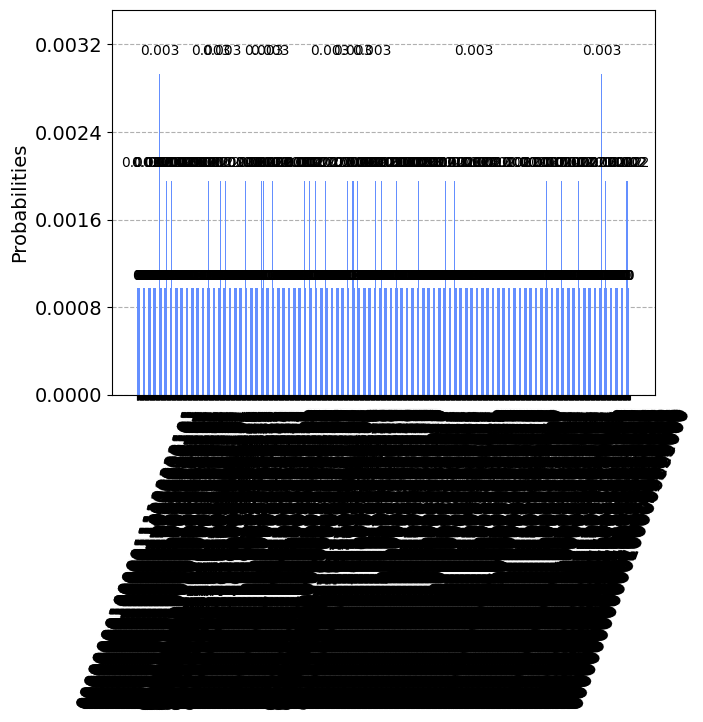

In [34]:
# Sort counts dictionary by frequency in descending order
plot_histogram(counts, sort='desc')


In [23]:
threshold = 0.0029
total_counts = sum(counts.values())

# Converti a probabilità
probs = {k: v / total_counts for k, v in counts.items()}

# Filtra le entry con probabilità > 0.0024
high_prob_results = {k: v for k, v in probs.items() if v > threshold}

# Mostra i risultati
for state, prob in high_prob_results.items():
    print(f"State: {state}, Probability: {prob:.6f}")


State: 00000000000001011010110000, Probability: 0.002930
State: 00000000011010101110001111, Probability: 0.002930
State: 00000000010000111011000100, Probability: 0.002930
State: 00000000010000110101000100, Probability: 0.002930
State: 00000000001101010010111110, Probability: 0.002930
State: 00000000001101110111111110, Probability: 0.002930
State: 00000000100000100110100101, Probability: 0.002930
State: 00000000011010100100100111, Probability: 0.002930
State: 00000000001101100010100110, Probability: 0.002930
State: 00000000000100100100010010, Probability: 0.002930


In [11]:
for c in counts:
    print(c,counts[c],int(c,2))

00000000010000111000111100 1 69180
00000000010000110001010100 1 68692
00000000010000100010001100 1 67724
00000000000001110101100000 1 7520
00000000010000101110101100 1 68524
00000000000001011010110000 3 5808
00000000100000001110011101 1 131997
00000000001000001000001011 1 33291
00000000000100101011011010 1 19162
00000000001101110111100110 1 56806
00000000000100110000110010 1 19506
00000000000001101101000000 1 6976
00000000010000101011010100 1 68308
00000000100000100101110101 1 133493
00000000011010001111001111 1 107471
00000000001000001100110011 1 33587
00000000000100000010001010 1 16522
00000000010000001101000100 1 66372
00000000000010110011110001 1 11505
00000000001101001110111110 1 54206
00000000100000011010011101 1 132765
00000000001000010111011011 1 34267
00000000011010111010001111 2 110223
00000000001000100000000011 1 34819
00000000000001000011000000 2 4288
00000000000001011110010000 1 6032
00000000011010100000100111 1 108583
00000000000001101010001000 1 6792
00000000000001111101